# Лабораторная работа №1 Звуки и сигналы

Кобыжев Александр, группа 3530901/80202

### Упражнение 1.2

In [4]:
from __future__ import print_function, division

%matplotlib inline

import thinkdsp
import thinkplot

import warnings
warnings.filterwarnings('ignore')

from IPython.html.widgets import interact, fixed
from IPython.display import display

Я выбрал этот звук: https://freesound.org/people/felix.blume/sounds/414062/

In [29]:
wave = thinkdsp.read_wave('sounds/414062__felix-blume__machine-gears.wav')
wave.normalize()
wave.make_audio()

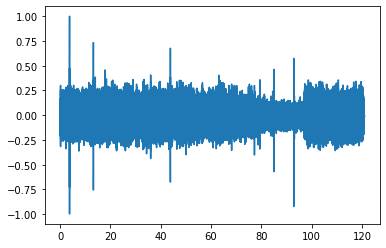

In [14]:
wave.plot()

In [15]:
segment = wave.segment(start=25, duration=0.5)
segment.make_audio()

Я выбрал примерно полусекундный сегмент, где, как мне кажется, высота постоянна.

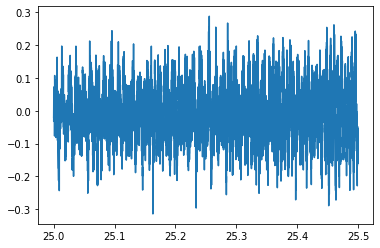

In [16]:
segment.plot()

Теперь рассмотрим спектр сегмента звука

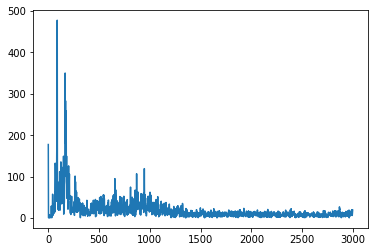

In [19]:
spectrum = segment.make_spectrum()
spectrum.plot(high=3000)

Теперь давайте рассмотрим основные и доминирующие частоты

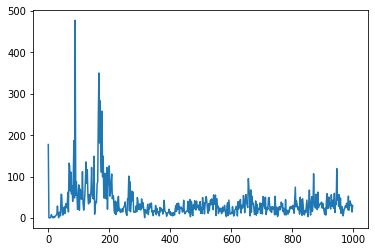

In [21]:
spectrum = segment.make_spectrum()
spectrum.plot(high=1000)

Пики могут отображать самые высокие точки в спектре и их частоты в порядке убывания. Это может помочь отфильтровать некоторые гармоники

In [22]:
spectrum.peaks()[:30]

[(477.12651815782436, 88.0),
 (349.78356868530363, 166.0),
 (282.7682770271516, 170.0),
 (257.9959018541909, 176.0),
 (241.34058048533615, 164.0),
 (186.61794990338055, 84.0),
 (181.12766751136527, 168.0),
 (177.34814169151826, 0.0),
 (157.95871927000582, 172.0),
 (149.43185101975794, 180.0),
 (149.14523507428788, 150.0),
 (135.43157096550385, 124.0),
 (132.31096277693203, 68.0),
 (126.03280864487395, 70.0),
 (125.78404373338199, 200.0),
 (122.03771045731844, 192.0),
 (121.9978844128709, 142.0),
 (119.22228552637446, 946.0),
 (116.56985643634354, 128.0),
 (111.97150490905403, 112.0),
 (110.96738906342934, 74.0),
 (110.30567932667302, 174.0),
 (107.97413765938968, 186.0),
 (106.82983478456184, 870.0),
 (106.16611169214379, 208.0),
 (101.22634883171585, 264.0),
 (100.31004880713746, 82.0),
 (99.62009343933141, 178.0),
 (99.24076695835758, 122.0),
 (95.08575904720958, 656.0)]

Доминирующий пик находится на частоте 88 Гц. Это тоже фундаментальный пик. Затем мы можем отфильтровать высокие частоты

In [30]:
spectrum.low_pass(2000)
spectrum.make_wave().make_audio()

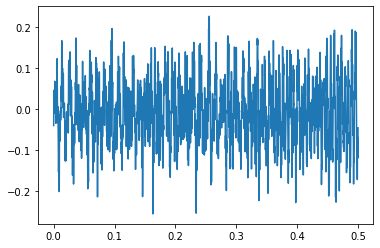

In [27]:
spectrum.make_wave().plot()

Как видно из графика, сигнал после фильтрации значительно поредел

Следующее взаимодействие позволяет нам выбрать сегмент и применить различные фильтры. Взят этот код из упражнения 1.1.

In [25]:
def filter_wave(wave, start, duration, cutoff):
    """Selects a segment from the wave and filters it.
    
    Plots the spectrum and displays an Audio widget.
    
    wave: Wave object
    start: time in s
    duration: time in s
    cutoff: frequency in Hz
    """
    segment = wave.segment(start, duration)
    spectrum = segment.make_spectrum()

    spectrum.plot(high=5000, color='0.7')
    spectrum.low_pass(cutoff)
    spectrum.plot(high=5000, color='#045a8d')
    thinkplot.config(xlabel='Frequency (Hz)')
    
    audio = spectrum.make_wave().make_audio()
    display(audio)

In [26]:
interact(filter_wave, wave=fixed(wave), 
         start=(0, 5, 0.1), duration=(0, 5, 0.1), cutoff=(0, 5000, 100));

interactive(children=(FloatSlider(value=2.0, description='start', max=5.0), FloatSlider(value=2.0, description…

### Упражнение 1.3

Создадим сложный сигнал из объектов SinSignal и CosSignal

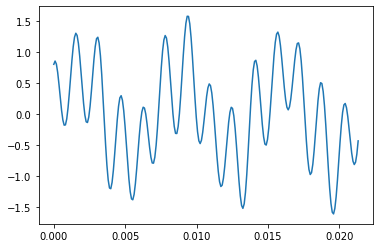

In [32]:
signal = (thinkdsp.SinSignal(freq=140, amp=0.7) +
          thinkdsp.SinSignal(freq=440, amp=0.2) +
          thinkdsp.CosSignal(freq=640, amp=0.8))
signal.plot()

Достаточно интересный звук получился, теперь попробуем его прослушать

In [33]:
wave2 = signal.make_wave(duration=1)
wave2.apodize()
wave2.make_audio()

Данное произведение искусства схоже с чем-то инопланетным, будто я попал в какую-то вселенную Звёздных Войн. Выведем спектр полученного звука.

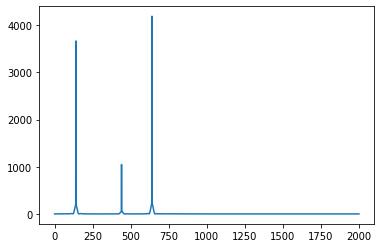

In [34]:
spectrum = wave2.make_spectrum()
spectrum.plot(high=2000)

Теперь попробуем добавить новую частоту, которая будет не кратна основным.

In [35]:
signal += thinkdsp.SinSignal(freq=1000)
signal.make_wave().make_audio()

Теперь слышно добавленную новую частоту, при чём более высокую, потому что freq=1000. Теперь звук более похож на набор цифр при звонке через стационарный телефон.

### Упражнение 1.4

За основу возьмём всё тот же звук, что и из Упражнения 1.2

In [41]:
wave3 = thinkdsp.read_wave('sounds/414062__felix-blume__machine-gears.wav')
wave3.normalize()
wave3.make_audio()

Теперь сделаем функцию stretch

In [42]:
def stretch(wave, factor):
    wave.ts *= factor
    wave.framerate /= factor

Попробуем прослушать полученный звук, введя 0.25

In [43]:
stretch(wave3, 0.25)
wave3.make_audio()

Теперь этот звук напоминает работающий блендер или мясорубку, аж есть захотелось. Проверим работоспособность нашей функции визуализируя полученный звук.

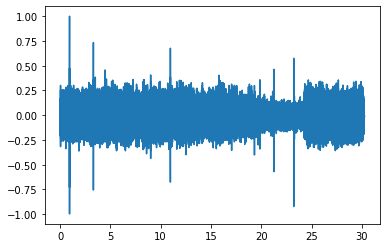

In [44]:
wave3.plot()